### SIFT
###
#### El método SIFT (Scale-Invariant Feature Transform) se utiliza para para detectar y describir puntos clave en una imagen que son invariantes a transformaciones como escala, rotación e iluminación.  SIFT localiza características distintivas en una imagen mediante la identificación de puntos de interés (keypoints) y el cálculo de descriptores, que representan la estructura local alrededor de cada punto clave. Estos descriptores se pueden comparar entre imágenes para encontrar coincidencias, lo cual permite reconocer objetos o partes de una escena incluso bajo variaciones significativas.

#### Primero realizamos la transformación de la imagen original en diversas formas, y la guardamos en la misma ubicación que la original. Las modificaciones que se aplican sobre la imagen son:
 
#### 1- Rotación: Aplica rotaciones de 15, 30, 45 y 60 grados.
#### 2- Traslación: Aplica desplazamientos de 30 o 50 píxeles en distintas direcciones.
#### 3- Escala: Cambia el tamaño de la imagen a escalas de 0.5, 0.75, 1.5 y 2.0.
#### 4- Iluminación: Ajusta el brillo de la imagen multiplicando los valores de píxeles.
#### 5- Perspectiva: Aplica dos transformaciones de perspectiva que deforman la imagen.
#### Además, se utilizará una imagen diferente a la elegida para probar si funciona correctamente el algoritmo implementado.

In [ ]:
import cv2
import numpy as np

# Se carga la imagen original
imagen = cv2.imread('lanus.png')

# Función para guardar la imagen modificada
def guardar_imagen(imagen, nombre):
    cv2.imwrite(nombre, imagen)

# 1. Rotación de la imagen
for angulo in [15, 30, 45, 60]:
    altura, ancho = imagen.shape[:2]
    matriz_rotacion = cv2.getRotationMatrix2D((ancho // 2, altura // 2), angulo, 1)
    imagen_rotada = cv2.warpAffine(imagen, matriz_rotacion, (ancho, altura))
    guardar_imagen(imagen_rotada, f'lanus_rotada_{angulo}.png')

# 2. Traslación de la imagen
for dx, dy in [(30, 50), (-30, -50), (50, -30), (-50, 30)]:
    matriz_traslacion = np.float32([[1, 0, dx], [0, 1, dy]])
    imagen_trasladada = cv2.warpAffine(imagen, matriz_traslacion, (ancho, altura))
    guardar_imagen(imagen_trasladada, f'lanus_trasladada_{dx}_{dy}.png')

# 3. Cambio de escala
for escala in [0.5, 0.75, 1.5, 2.0]:
    imagen_escalada = cv2.resize(imagen, None, fx=escala, fy=escala, interpolation=cv2.INTER_LINEAR)
    guardar_imagen(imagen_escalada, f'lanus_escalada_{escala}.png')

# 4. Cambio de iluminación
for alpha in [0.5, 1.5, 2.0]:  # Factor de brillo
    imagen_iluminada = cv2.convertScaleAbs(imagen, alpha=alpha, beta=0)
    guardar_imagen(imagen_iluminada, f'lanus_iluminada_{alpha}.png')

# 5. Transformación de perspectiva
puntos_originales = np.float32([[0, 0], [ancho - 1, 0], [0, altura - 1], [ancho - 1, altura - 1]])
puntos_destino = [
    np.float32([[0, 0], [ancho - 1, 0], [ancho * 0.1, altura - 1], [ancho * 0.9, altura - 1]]),
    np.float32([[ancho * 0.1, 0], [ancho * 0.9, 0], [0, altura - 1], [ancho - 1, altura - 1]]),
]
for i, destino in enumerate(puntos_destino):
    matriz_perspectiva = cv2.getPerspectiveTransform(puntos_originales, destino)
    imagen_perspectiva = cv2.warpPerspective(imagen, matriz_perspectiva, (ancho, altura))
    guardar_imagen(imagen_perspectiva, f'lanus_perspectiva_{i}.png')

print("Imágenes modificadas generadas y guardadas.")

#### Implementación del metodo SIFT
#### Se aplica el metodo y se compara la imagen original con todas las generadas en el bloque anterior para verificar si las imagenes son las mismas o no, y si puede detectarlo a partir de traslaciones, rotaciones, cambios en iluminacion, cambios de escala y movimientos de perspectiva.

####

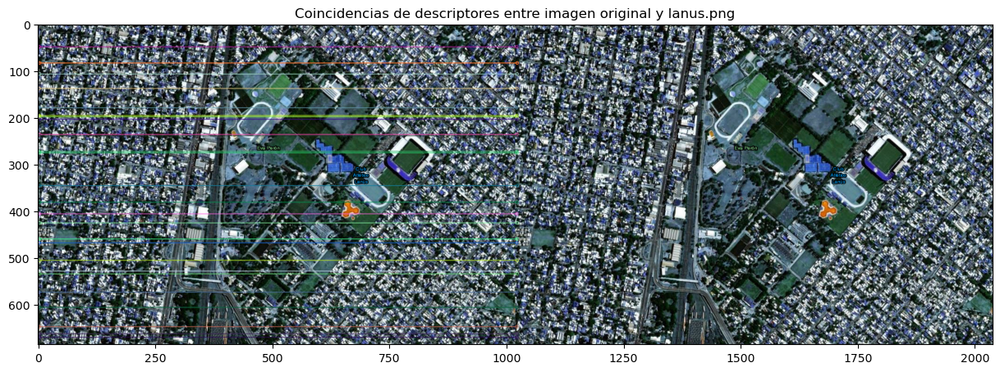


Comparación con lanus.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus.png: 18025
Total de coincidencias encontradas: 18025
Las imágenes son probablemente las mismas.


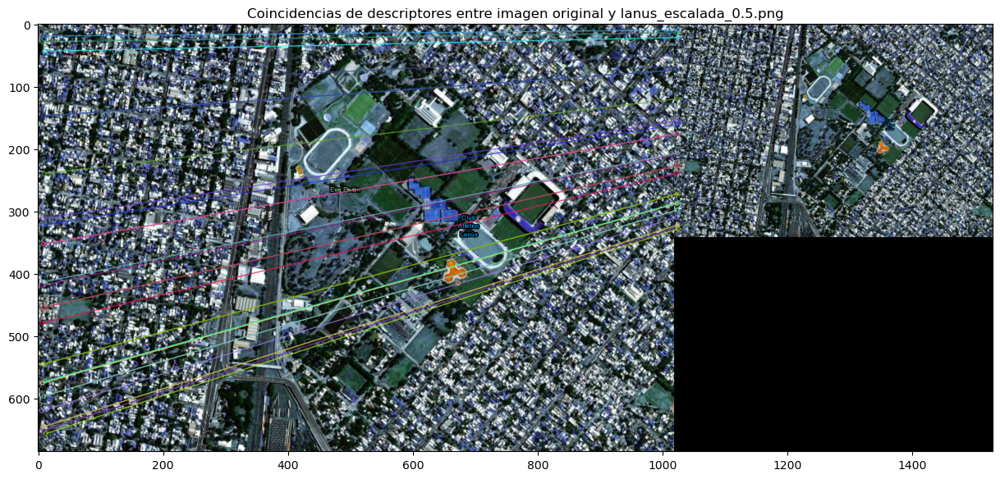


Comparación con lanus_escalada_0.5.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_escalada_0.5.png: 4297
Total de coincidencias encontradas: 3012
Las imágenes son probablemente las mismas.


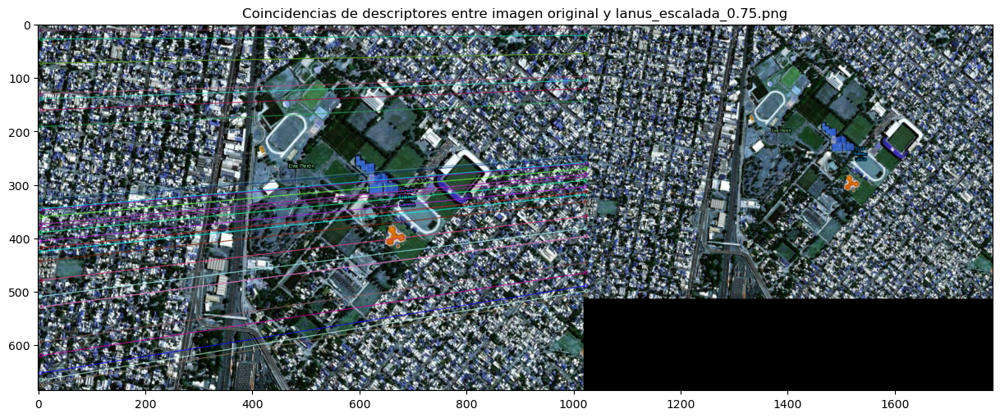


Comparación con lanus_escalada_0.75.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_escalada_0.75.png: 10898
Total de coincidencias encontradas: 7375
Las imágenes son probablemente las mismas.


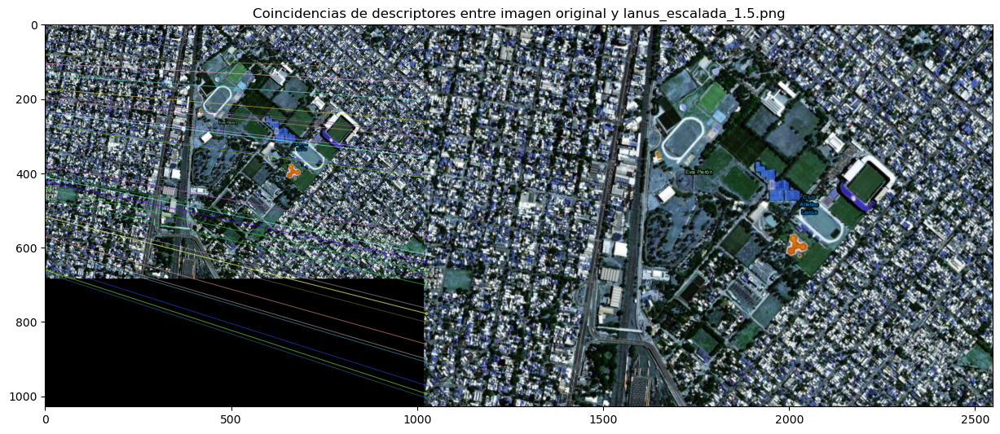


Comparación con lanus_escalada_1.5.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_escalada_1.5.png: 36929
Total de coincidencias encontradas: 11667
Las imágenes son probablemente las mismas.


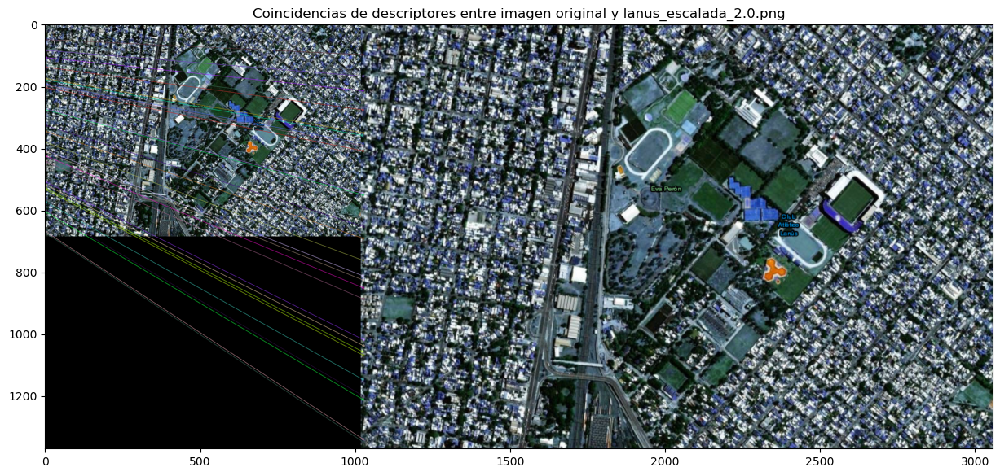


Comparación con lanus_escalada_2.0.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_escalada_2.0.png: 44852
Total de coincidencias encontradas: 12181
Las imágenes son probablemente las mismas.
Pocas coincidencias encontradas entre la imagen original y lanus_falsa.jpg.
Pocas coincidencias encontradas entre la imagen original y lanus_falsa2.png.
Pocas coincidencias encontradas entre la imagen original y lanus_falsa3.png.


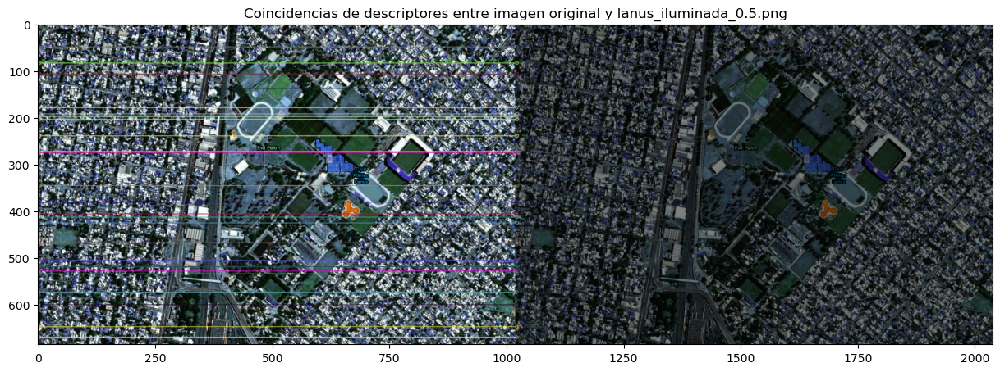


Comparación con lanus_iluminada_0.5.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_iluminada_0.5.png: 15751
Total de coincidencias encontradas: 15016
Las imágenes son probablemente las mismas.


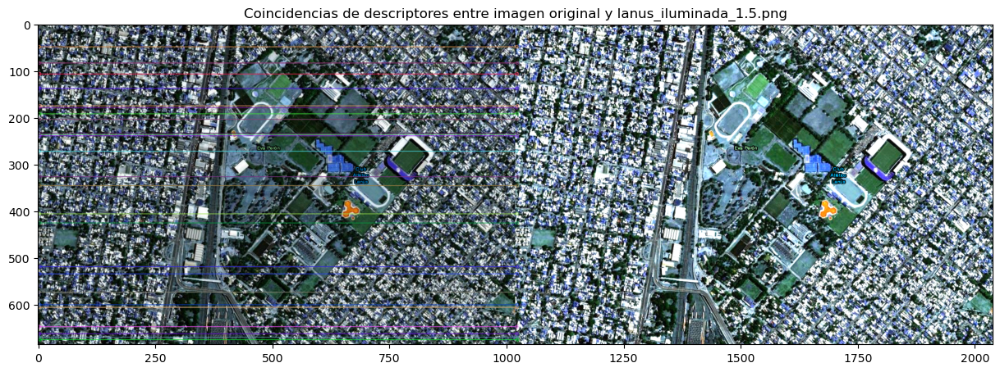


Comparación con lanus_iluminada_1.5.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_iluminada_1.5.png: 18504
Total de coincidencias encontradas: 10138
Las imágenes son probablemente las mismas.


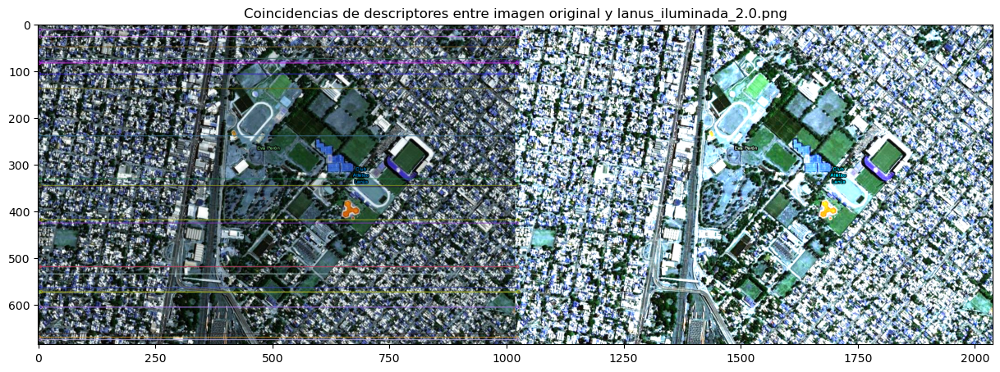


Comparación con lanus_iluminada_2.0.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_iluminada_2.0.png: 18509
Total de coincidencias encontradas: 4255
Las imágenes son probablemente las mismas.


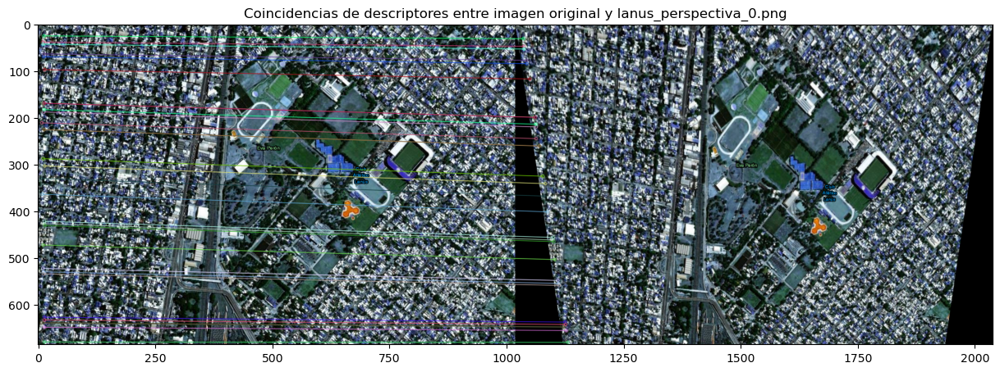


Comparación con lanus_perspectiva_0.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_perspectiva_0.png: 17562
Total de coincidencias encontradas: 8286
Las imágenes son probablemente las mismas.


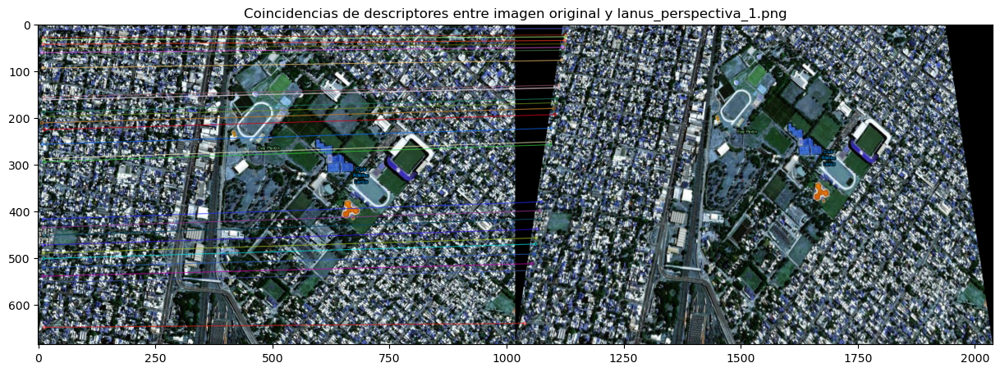


Comparación con lanus_perspectiva_1.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_perspectiva_1.png: 17577
Total de coincidencias encontradas: 8342
Las imágenes son probablemente las mismas.


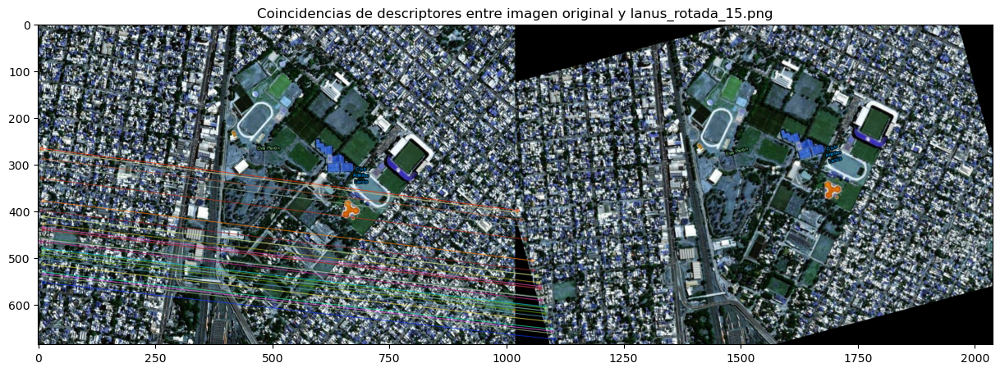


Comparación con lanus_rotada_15.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_rotada_15.png: 17218
Total de coincidencias encontradas: 10371
Las imágenes son probablemente las mismas.


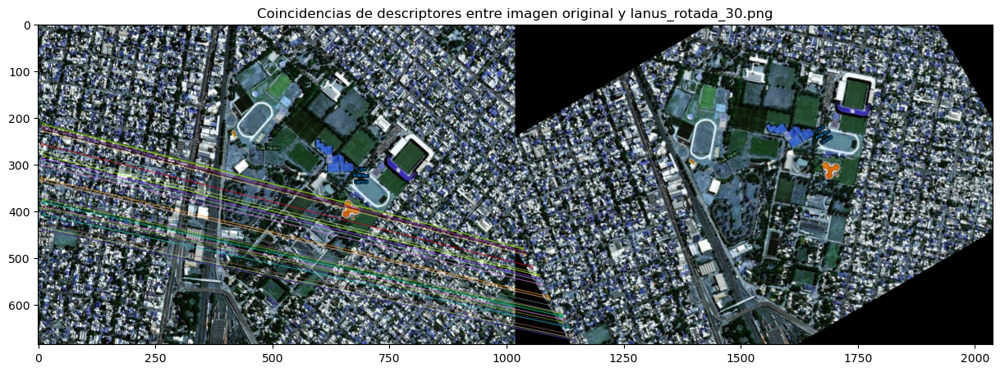


Comparación con lanus_rotada_30.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_rotada_30.png: 15778
Total de coincidencias encontradas: 9620
Las imágenes son probablemente las mismas.


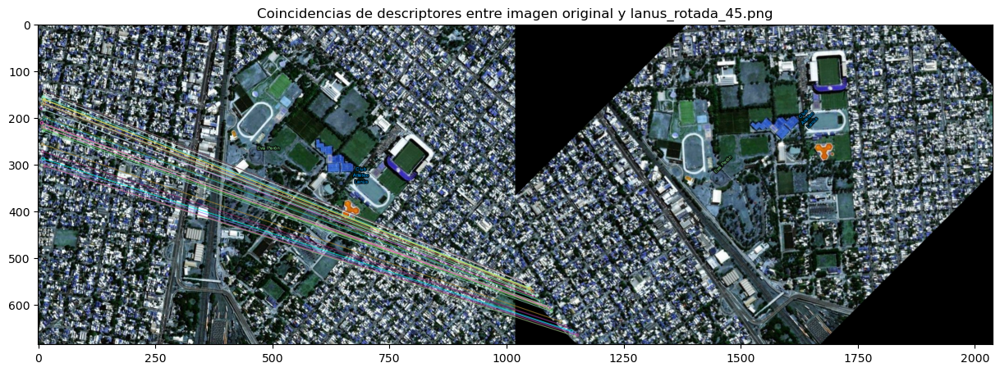


Comparación con lanus_rotada_45.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_rotada_45.png: 14971
Total de coincidencias encontradas: 9086
Las imágenes son probablemente las mismas.


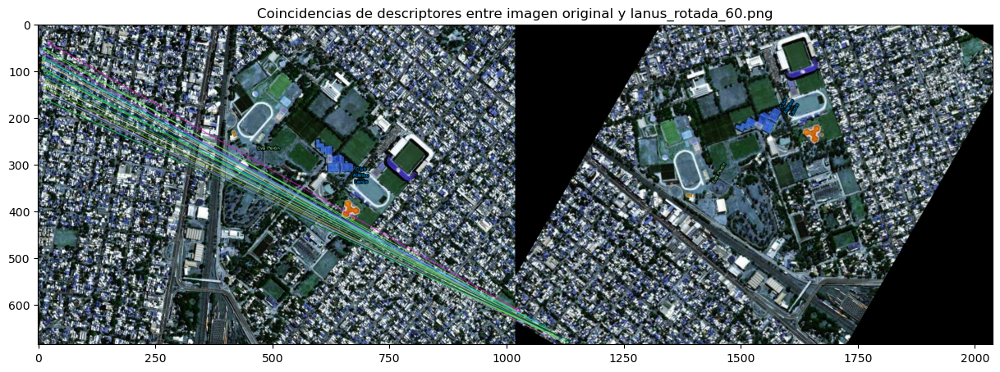


Comparación con lanus_rotada_60.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_rotada_60.png: 14360
Total de coincidencias encontradas: 8693
Las imágenes son probablemente las mismas.


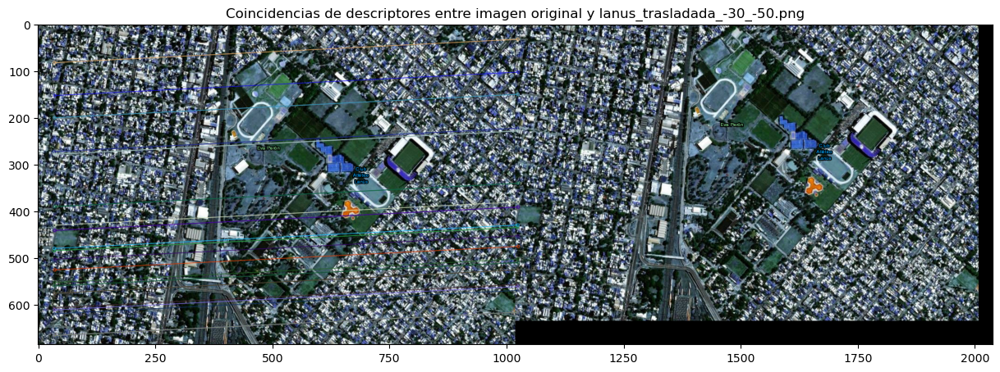


Comparación con lanus_trasladada_-30_-50.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_trasladada_-30_-50.png: 16170
Total de coincidencias encontradas: 15433
Las imágenes son probablemente las mismas.


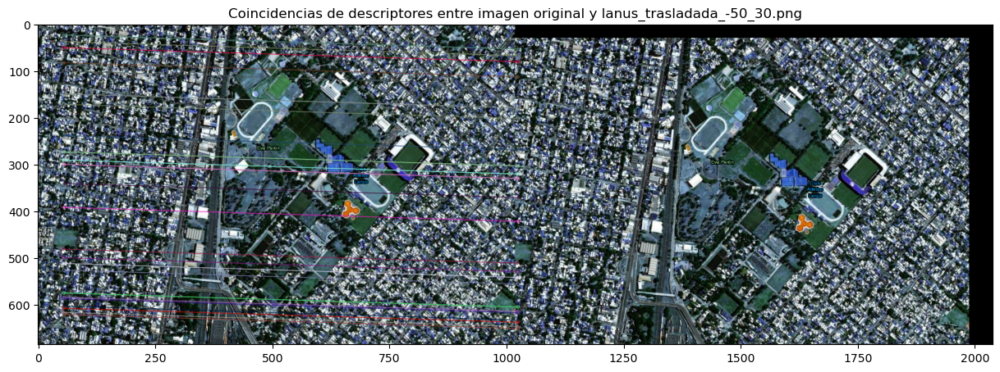


Comparación con lanus_trasladada_-50_30.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_trasladada_-50_30.png: 16398
Total de coincidencias encontradas: 15680
Las imágenes son probablemente las mismas.


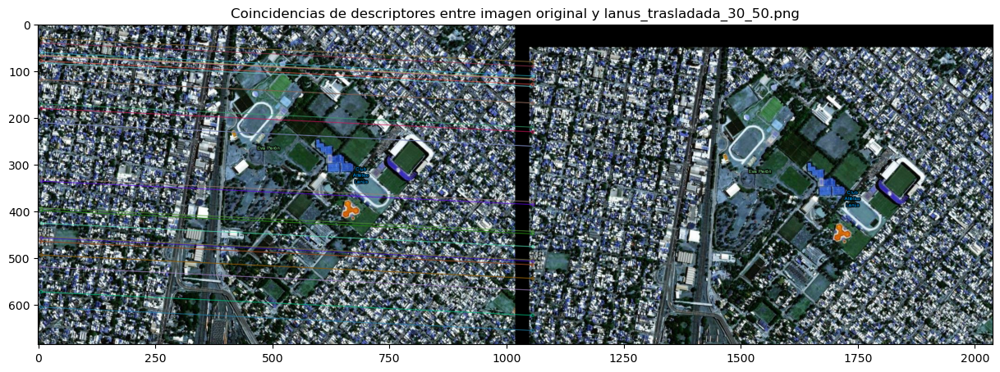


Comparación con lanus_trasladada_30_50.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_trasladada_30_50.png: 16260
Total de coincidencias encontradas: 15500
Las imágenes son probablemente las mismas.


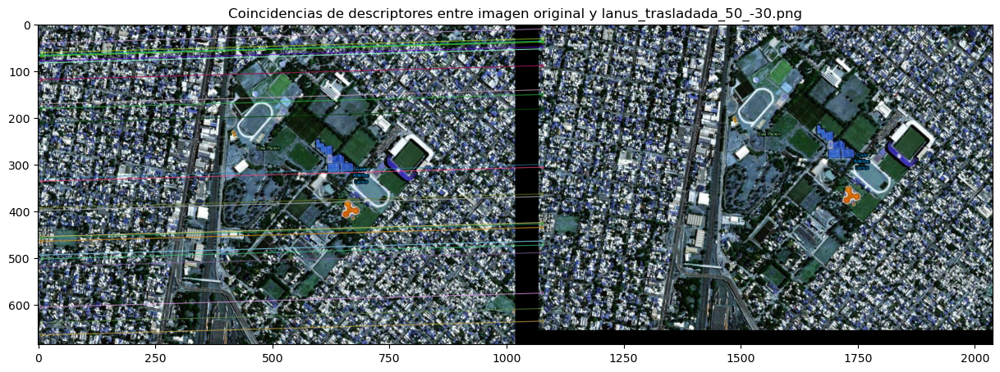


Comparación con lanus_trasladada_50_-30.png:
Número de puntos clave en la imagen original: 18025
Número de puntos clave en lanus_trasladada_50_-30.png: 16400
Total de coincidencias encontradas: 15577
Las imágenes son probablemente las mismas.


In [20]:
import cv2
import os
import matplotlib.pyplot as plt

directorio_imagenes = "./" 

# Se carga la imagen original
imagen_original = cv2.imread('lanus.png')
imagen_original_gray = cv2.cvtColor(imagen_original, cv2.COLOR_BGR2GRAY)

# Se inicializa el detector SIFT
sift = cv2.SIFT_create()

# Detectar los puntos clave y calcular los descriptores de la imagen original
keypoints1, descriptors1 = sift.detectAndCompute(imagen_original_gray, None)

# Configurar el matcher con FLANN (Fast Library for Approximate Nearest Neighbors)
index_params = dict(algorithm=1, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Recorrer cada imagen generada en el directorio
for nombre_archivo in os.listdir(directorio_imagenes):
    if nombre_archivo.startswith("lanus"):
        # Cargar la imagen modificada
        imagen_modificada = cv2.imread(os.path.join(directorio_imagenes, nombre_archivo))
        imagen_modificada_gray = cv2.cvtColor(imagen_modificada, cv2.COLOR_BGR2GRAY)

        # Detectar puntos clave y descriptores de la imagen modificada
        keypoints2, descriptors2 = sift.detectAndCompute(imagen_modificada_gray, None)

        # Realizar la coincidencia de descriptores con KNN
        matches = flann.knnMatch(descriptors1, descriptors2, k=2)

        # Aplicar la razón de Lowe para filtrar las mejores coincidencias con un umbral más bajo
        good_matches = []
        for m, n in matches:
            if m.distance < 0.5 * n.distance:  # Ajuste a 0.5 para aún mayor restricción
                good_matches.append(m)

        # Filtrar coincidencias visualizadas si son pocas o inadecuadas
        if len(good_matches) < 10:
            print(f"Pocas coincidencias encontradas entre la imagen original y {nombre_archivo}.")
            continue  # Salta a la siguiente imagen si hay pocas coincidencias

        # Limitar el número de coincidencias visualizadas
        imagen_coincidencias = cv2.drawMatches(imagen_original, keypoints1, imagen_modificada, keypoints2, good_matches[:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

        # Mostrar la imagen con coincidencias
        plt.figure(figsize=(15, 10))
        plt.imshow(imagen_coincidencias)
        plt.title(f"Coincidencias de descriptores entre imagen original y {nombre_archivo}")
        plt.show()

        # Calcular la cantidad de coincidencias
        num_keypoints1 = len(keypoints1)
        num_keypoints2 = len(keypoints2)
        num_matches = len(good_matches)

        print(f"\nComparación con {nombre_archivo}:")
        print(f"Número de puntos clave en la imagen original: {num_keypoints1}")
        print(f"Número de puntos clave en {nombre_archivo}: {num_keypoints2}")
        print(f"Total de coincidencias encontradas: {num_matches}")

        # Determinar similitud en función de las coincidencias
        threshold = 0.1 * min(num_keypoints1, num_keypoints2)
        if num_matches > threshold:
            print("Las imágenes son probablemente las mismas.")
        else:
            print("Las imágenes son diferentes.")


### Conclusión

#### El método implementado logra detectar los patrones similares en las imagenes transformadas a partir de la original. Sin embargo, en casos de algunas modificaciones cuando la imagen sufre cambios significativos en perspectiva o resolución, la cantidad de coincidencias efectivas puede disminuir. Para los casos donde realizamos la comparacion entre imagenes que no se generaron a partir de la original, se puede ver que el algoritmo encuentra pocas coincidencias entre las imagenes, y no termina generando un resultado final, a diferencia de las generadas a partir de la original.